
# NOAA GOES Satellite Image Next Step Prediction

This demo ML project takes a period of time-series satellite images and attempts to predict the next step. 
We do this be creating sequences of 8 timestep images and try to predict the 9th step. 

The satellite images come from NOAA GOES east: https://www.star.nesdis.noaa.gov/GOES/conus.php?sat=G16

The images we are using in this project focusing on the tropical storm Rafael:  https://www.kaggle.com/datasets/whisperingkahuna/tropical-storm-rafael-satellite-image-dataset
* Satellite Source: NOAA - GOES-East
* Period Covered: November 3, 2023, to November 8, 2023
* Interval Generation: 20-minute intervals throughout a 24-hour period
* Format: .jpg

To save space the processed images have been added to the project in the folder titled: GOES_images_processed


##  Set up

In [1]:
from PIL import Image
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# input_dir = "Satellite_Images_NOAA_GOES_Grayscale" # Not used, as processed images included.
output_dir = "GOES_images_processed"
image_filetype = '.jpg'

# Create a new conda env with tensorflow-gpu, (not tensorflow) and other required packages. 

## Resize the image files

In [2]:
input_dir = "GOES_images_processed"

def resize_images():
  new_size = (128, 128) # RESIZE IMAGES TO HELP WITH TRAINING (I have chosen 128*128 to reduce GPU VRAM usage)

  # Create the output directory if it doesn't exist.
  if not os.path.exists(output_dir):
    os.makedirs(output_dir)

  # Loop through all files in the input directory
  for filename in os.listdir(input_dir):
    if filename.endswith((image_filetype)):
      img_path = os.path.join(input_dir, filename)
      img = Image.open(img_path)

      # Resize the image
      resized_img = img.resize(new_size)

      # Save the image
      resized_img.save(os.path.join(output_dir, filename))

  print("Image cropping and resizing completed")

# resize_images() # Uncomment if you want to use this function to change the image size. 

## Convert images into a numpy array.

In [3]:
# Initialize an empty list to store the images
images = []

for filename in sorted(os.listdir(output_dir)):
    if filename.endswith((image_filetype)):
        img_path = os.path.join(output_dir, filename)
        img = Image.open(img_path).convert('L')  # Ensures Greyscale image with 1 color channel. 
        img_array = np.array(img)
        images.append(img_array)

# Convert the list of images to a NumPy array
images_array = np.array(images)

print("Images loaded to numpy array")

Images loaded to numpy array


In [4]:
images_array.shape
# 432 - number of images
# x * x - pixel height * width

(432, 128, 128)

## Animate Images

In [5]:
def animate(images_array):
  fig, ax = plt.subplots()
  im = ax.imshow(images_array[0])
  plt.axis('off')

  def anim_(i):
    im.set_data(images_array[i])

  anim = animation.FuncAnimation(
      fig, anim_, interval=50, frames=images_array.shape[0], repeat_delay=1000)
  plt.close(fig)
  return anim


In [6]:
ani = animate(images_array[:75])
HTML(ani.to_jshtml())

## Add sequences of images for Test and Training.

In [7]:
sequence_length = 8

X = []
y = []

for i in range (len(images_array) - sequence_length):
  X.append(images_array[i:i+sequence_length]) # Take n images in a row
  y.append(images_array[i+sequence_length]) # Take n+1 image as a target.

X = np.array(X)
y = np.array(y)

X.shape, y.shape

((424, 8, 128, 128), (424, 128, 128))

In [8]:
from sklearn.model_selection import train_test_split

# Add the channel dimension for model training
X = np.expand_dims(X, axis=-1)
y = np.expand_dims(y, axis=-1)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)

In [9]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((339, 8, 128, 128, 1),
 (85, 8, 128, 128, 1),
 (339, 128, 128, 1),
 (85, 128, 128, 1))

## Visualise a sequency of training images and the target.

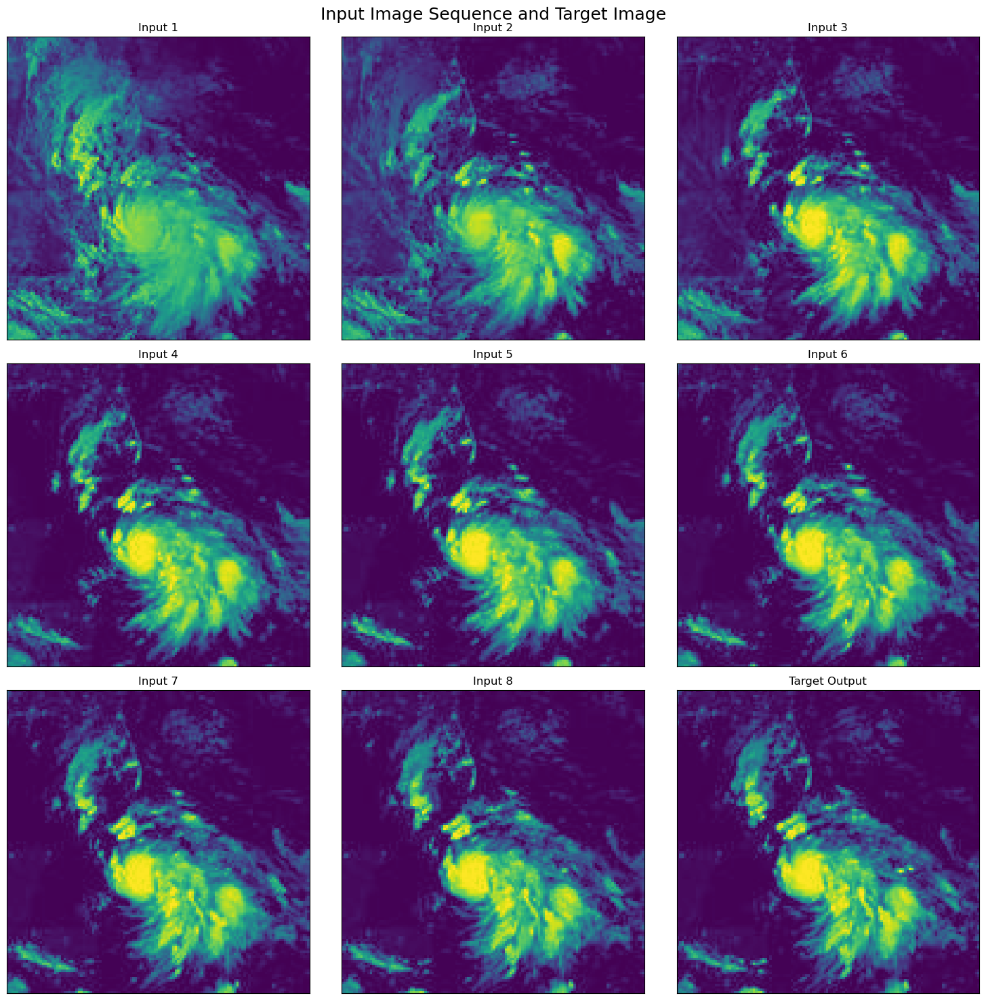

In [10]:
# plot an input/output pair
i_plt = np.random.choice(X_train.shape[0])

# Create a figure with a 2x5 grid of subplots
fig, axs = plt.subplots(3, 3)
fig.set_size_inches(15, 15)

# Plot the 9 input images
for jj in range(8):
    ax = axs[jj // 3, jj % 3]
    ax.imshow(X_train[i_plt, jj])
    ax.set_title(f'Input {jj+1}')
    ax.set_xticks([])
    ax.set_yticks([])

# Plot the target output image
ax = axs[2, 2]
ax.imshow(y_train[i_plt])
ax.set_title('Target Output')
ax.set_xticks([])
ax.set_yticks([])

fig.suptitle('Input Image Sequence and Target Image', fontsize = 18)

plt.tight_layout()
plt.show()

## Convolutional Neural Network

In [11]:
import keras
import tensorflow as tf
from keras import Sequential
from keras.layers import Input, ConvLSTM2D, BatchNormalization, Reshape, Conv2D
from keras.callbacks import EarlyStopping

2025-02-06 12:05:59.919174: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-02-06 12:05:59.931111: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-02-06 12:05:59.934815: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-02-06 12:05:59.946629: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [12]:
# Check for GPU resources:

print(tf.__version__)  # Should be 2.9 or higher
print("Num GPUs Available:", len(tf.config.list_physical_devices('GPU')))
print(tf.config.list_physical_devices('GPU'))

2.17.0
Num GPUs Available: 1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


I0000 00:00:1738843561.619957   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1738843561.670231   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1738843561.673969   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355


In [13]:
! nvidia-smi

Thu Feb  6 12:06:01 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.144.03             Driver Version: 550.144.03     CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A10G                    On  |   00000000:00:1E.0 Off |                    0 |
|  0%   28C    P8             18W /  300W |       4MiB /  23028MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [14]:
tf.config.run_functions_eagerly(True)
tf.config.optimizer.set_jit(False)  # Disable JIT optimization

In [15]:
# Check the shape of the data
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((339, 8, 128, 128, 1),
 (85, 8, 128, 128, 1),
 (339, 128, 128, 1),
 (85, 128, 128, 1))

In [16]:
# Scale Image Values
X_train_scaled = X_train / 255.0
X_test_scaled = X_test / 255.0
y_train_scaled = y_train / 255.0
y_test_scaled = y_test / 255.0

X_train_scaled.shape

(339, 8, 128, 128, 1)

In [17]:
# Input Shape Dimensions 
sequences = X_train_scaled.shape[0]
images = X_train_scaled.shape[1]
height = X_train_scaled.shape[2]
width = X_train_scaled.shape[3]
channels = X_train_scaled.shape[4]

In [18]:
# Training Parameters
epochs = 20
batch_size = 4
filters = 64
kernel_size = (3,3)
padding = "same"
activation = "relu"
output_activation = "sigmoid"
loss = "mse"
optimizer = tf.keras.optimizers.Adam()

I0000 00:00:1738843562.350964   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1738843562.353544   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1738843562.355787   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
I0000 00:00:1738843562.488349   13769 cuda_executor.cc:1015] successful NUMA node read from SysFS ha

In [19]:
%%time

# Define a function to create and train the Convolutional Model

def train_model():
    model = Sequential([
        Input(shape=(images, height, width, channels)),  # (8, 256, 256, 1)

        # ConvLSTM2D approach - 7hr 25mins training time on Apple M1 Pro.
        ConvLSTM2D(filters=filters, kernel_size=kernel_size, activation=activation, padding=padding, return_sequences=True),
        BatchNormalization(),

        ConvLSTM2D(filters=filters, kernel_size=kernel_size, activation=activation, padding=padding, return_sequences=False),
        BatchNormalization(),

        Conv2D(filters=1, kernel_size=kernel_size, activation=output_activation, padding=padding),

        Reshape((height, width, channels))
    ])

    # Compile the model
    model.compile(optimizer=optimizer, loss=loss)
    print("Model created and compiled. Starting training...")

    early_stopping = EarlyStopping(patience=5, restore_best_weights=True)
    history = model.fit(X_train_scaled, y_train_scaled, epochs=epochs, batch_size=batch_size, validation_split=0.2, callbacks=[early_stopping])
    return model, history

# Define the model filename
model_filename = "GOES_satellite_prediction_model.keras"

# The model takes ~6 mins on A10 GPU but substancially longer on CPU architectures.
# Therefore we have saved the model to the project directory and will attempt to load it to save time training for this demo.

# Check if the model exists and if it does load it instead of training. 
if os.path.exists(model_filename):
    model = tf.keras.models.load_model(model_filename)
    print("Model loaded")

# Can not find the model in the directory, so start training. 
else: 
    print("No model found, commence training...")
    model, history = train_model()

    # Save Model
    model.save(model_filename)
    print("Model saved")


No model found, commence training...
Model created and compiled. Starting training...


/home/coder/anaconda3/envs/data_readiness_gpu/lib/python3.12/site-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


Epoch 1/20


2025-02-06 12:06:04.002195: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 90101
W0000 00:00:1738843564.085331   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.102336   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.102828   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.103291   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.103776   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.111795   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.113592   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843564.114887   13769 gpu_

67/68 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step - loss: 0.0608 

W0000 00:00:1738843582.888108   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.888577   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.888983   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.889386   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.889794   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.890212   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.890624   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.891033   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843582.891463   13769 gp

68/68 ━━━━━━━━━━━━━━━━━━━━ 21s 284ms/step - loss: 0.0600 - val_loss: 0.0676
Epoch 2/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 277ms/step - loss: 0.0128 - val_loss: 0.0628
Epoch 3/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 277ms/step - loss: 0.0122 - val_loss: 0.0632
Epoch 4/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 280ms/step - loss: 0.0071 - val_loss: 0.0717
Epoch 5/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 278ms/step - loss: 0.0076 - val_loss: 0.0648
Epoch 6/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 280ms/step - loss: 0.0061 - val_loss: 0.0677
Epoch 7/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 277ms/step - loss: 0.0057 - val_loss: 0.0359
Epoch 8/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 278ms/step - loss: 0.0050 - val_loss: 0.0166
Epoch 9/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 276ms/step - loss: 0.0067 - val_loss: 0.0143
Epoch 10/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 279ms/step - loss: 0.0056 - val_loss: 0.0057
Epoch 11/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 278ms/step - loss: 0.0048 - val_loss: 0.0169
Epoch 12/20
68/68 ━━━━━━━━━━━━━━━━━━━━ 19s 282ms/ste

## Plot Loss Graph

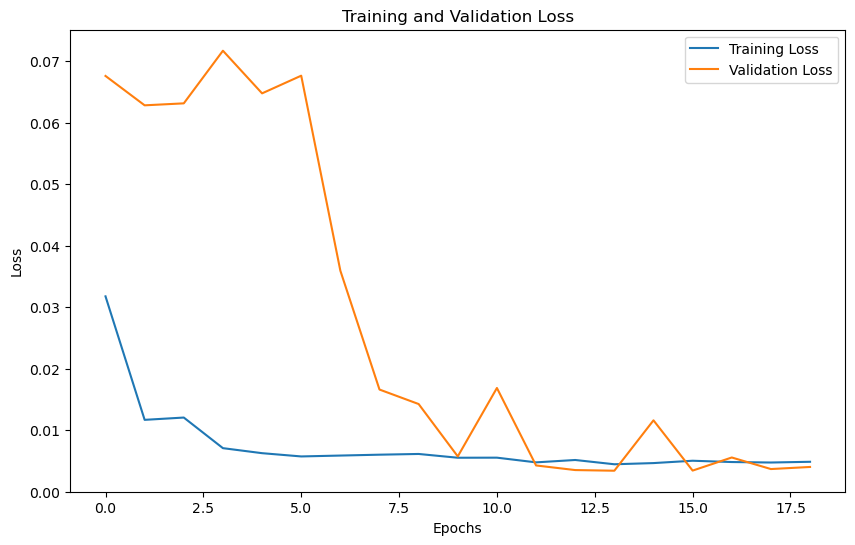

In [20]:
def plot_loss(history):
  plt.figure(figsize=(10,6))

  plt.plot(history.history["loss"], label="Training Loss")
  plt.plot(history.history["val_loss"], label="Validation Loss")
  plt.title("Training and Validation Loss")
  plt.xlabel("Epochs")
  plt.ylabel("Loss")
  plt.legend()
  plt.show()

try:
  plot_loss(history)
except NameError:
  print("History not accessible from loaded model")

In [21]:
# Predict on the validation set
y_pred_scaled = model.predict(X_test_scaled)
y_pred = y_pred_scaled * 255.0

y_pred = np.clip(y_pred, 0, 255).astype(np.uint8)
y_pred.shape

W0000 00:00:1738843926.475108   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.475881   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.476581   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.477287   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.477999   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.478881   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.479928   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.481116   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843926.481874   13769 gp

1/3 ━━━━━━━━━━━━━━━━━━━━ 2s 1s/step

W0000 00:00:1738843927.340465   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.342773   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.345040   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.347383   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.349768   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.351892   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.353867   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.355704   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.358314   13769 gp

2/3 ━━━━━━━━━━━━━━━━━━━━ 0s 477ms/step

W0000 00:00:1738843927.931083   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.931747   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.932336   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.932929   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.933518   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.934230   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.935051   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.935965   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843927.936583   13769 gp

3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 581ms/step


W0000 00:00:1738843928.532990   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.534640   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.536253   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.537908   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.539613   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.541132   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.542526   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.543867   13769 gpu_timer.cc:114] Skipping the delay kernel, measurement accuracy will be reduced
W0000 00:00:1738843928.545722   13769 gp

(85, 128, 128, 1)

In [24]:
def show_true_vs_predicted(y_test, y_pred, num_images=1):
  indices = np.random.choice(len(y_test), num_images, replace=False)

  fig, axs = plt.subplots(num_images, 2, figsize=(10,20))
  for i, idx in enumerate(indices):
    # True Image
    axs[i, 0].imshow(y_test[idx])
    axs[i, 0].set_title("True Image")
    axs[i, 0].axis("off")

    # Predicted Image
    axs[i, 1].imshow(y_pred[idx])
    axs[i, 1].set_title("Predicted Image")
    axs[i, 1].axis("off")

  plt.tight_layout()
  plt.show()

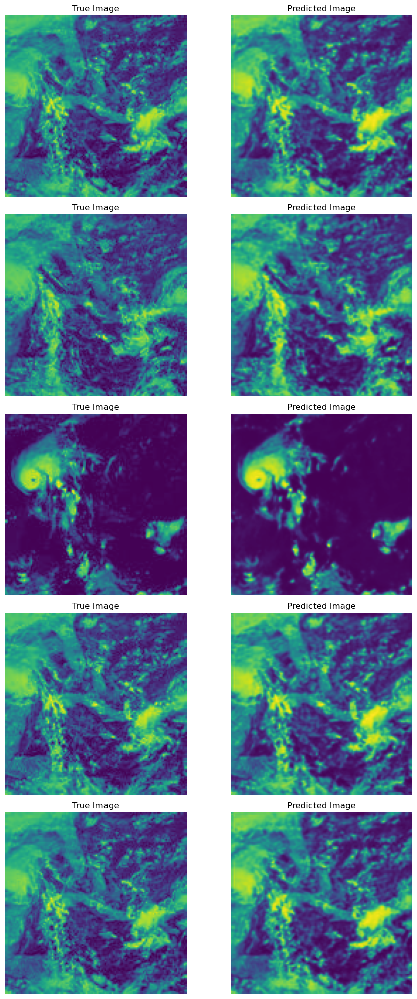

In [25]:
show_true_vs_predicted(y_test, y_pred, num_images=5)